# **Imports and Installs**

In [ ]:
%pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.121 🚀 Python-3.10.12 torch-2.0.1+cu118 CPU
Setup complete ✅ (4 CPUs, 25.5 GB RAM, 24.1/225.8 GB disk)


In [ ]:
# Here I am Download COCO val
import torch
torch.hub.download_url_to_file('https://ultralytics.com/assets/coco2017val.zip', 'tmp.zip')  # download (780M - 5000 images)
!unzip -q tmp.zip -d datasets && rm tmp.zip  # unzip

100%|██████████| 780M/780M [00:23<00:00, 34.6MB/s]


In [ ]:
# Validate YOLOv8n on COCO128 val
!yolo val model=yolov8n.pt data=coco128.yaml

In [ ]:
import numpy as np
import pandas as pd
import cv2 as cv
import os
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from ultralytics.yolo.utils.plotting import ImageDraw
import matplotlib.patches as patches
import torchvision.transforms as T
from PIL import Image
from google.colab import drive
from ultralytics import YOLO
import glob

# **Importing the Data**

In [ ]:
# Mounting the Google Drive where I have stored the data
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!unzip '/content/gdrive/MyDrive/test (1).zip'

# **TASK 1**

For Task 1 I have to classify the road lanes as being occupied or not. It is considered that if a lane is occupied, it should be labeled 1, else 0.

I started with saving the images in a list, checking their size and making an idea on how do they look like.

In [ ]:
pictures=[]
for img in os.listdir('/content/Task1'):
  image=cv.imread(os.path.join('/content/Task1', img))
  if image is not None:
    pictures.append(image)


In [ ]:
# Checking the size
len(pictures)

50

uint8
(880, 1920, 3)


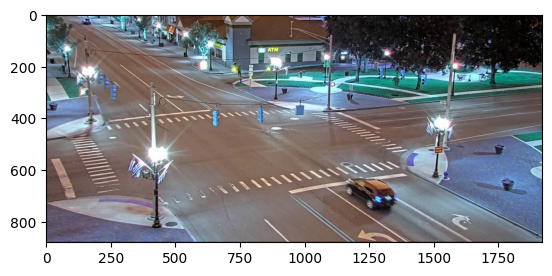

In [ ]:
for i in pictures:
  # Also wanted to check the input type of picture to be unit8
  print(i.dtype)
  print(i.shape)
  plt.imshow(i)
  plt.show()
  break

**Preprocc Images**

For processing part, I resized the images as 640x640, then normalized them with NORM_MINMAX so the minimum value would be alpha and the maximum one, beta. I treated a problem that I encountered with Yolo so the axis won't be a mismatch.

In [ ]:
prc_ims=[]
for im in pictures:
    im_resize = cv.resize(im,(640,640))
    if im_resize.ndim == 2:
        im_resize = cv.cvtColor(im_resize, cv.COLOR_GRAY2RGB)
    elif im_resize.shape[2] == 1:
        im_resize = cv.cvtColor(im_resize, cv.COLOR_BGRA2BGR)
    normalized_image = cv.normalize(im_resize, None, alpha=0, beta=255, norm_type=cv.NORM_MINMAX, dtype=cv.CV_8UC1)
    prc_ims.append(normalized_image)



**YOLOv8**

For this task I chose to use the YOLO v8 model from Ultralytics since it's the newest approach in computer vision. It is computed to be fast, accurate and has an impressive result on object detection and tracking.

In [ ]:
# I loaded the pretrained model
model_yolo_t1 = YOLO('yolov8n.pt')
# Then I trained the model on COCO dataset for 5 epochs, having the image size of 640x640
model_yolo_t1.train(data='coco128.yaml', epochs=5, imgsz=640)

**Proccesing all the results from the model**

In [ ]:
# I applied the model on my proccessed images and stored all the results in a list
res_all=[]
for p in prc_ims:
  result = model_yolo_t1(p)
  res_all.append(result)


0: 640x640 1 person, 1 car, 4 traffic lights, 1 stop sign, 238.3ms
Speed: 3.7ms preprocess, 238.3ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 6 persons, 4 cars, 1 truck, 1 traffic light, 191.3ms
Speed: 2.4ms preprocess, 191.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 cars, 3 traffic lights, 204.1ms
Speed: 2.7ms preprocess, 204.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 1 car, 1 bus, 1 train, 1 truck, 2 traffic lights, 194.5ms
Speed: 2.9ms preprocess, 194.5ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 persons, 4 cars, 2 traffic lights, 200.9ms
Speed: 3.5ms preprocess, 200.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 3 traffic lights, 193.4ms
Speed: 2.5ms preprocess, 193.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 person, 5 cars, 1 truck, 216.7ms
Speed: 2.4m

In [ ]:
# I wanted to see how does one result look like to make use of it in future proccessing
for i in res_all:
  print(i)
  break

[ultralytics.yolo.engine.results.Results object with attributes:

boxes: ultralytics.yolo.engine.results.Boxes object
keypoints: None
keys: ['boxes']
masks: None
names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: '

In [ ]:
# Checking the arguments and seeing how the classes for each bounding box are stored in tensors
for r in res_all[:10]:
  res_plot = r[0].plot()
  boxes = r[0].boxes
  boundbox_cls = boxes.cls
  print(boundbox_cls)


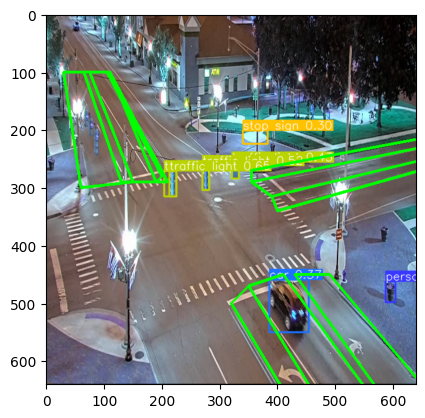

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 0
Lane 9: 1


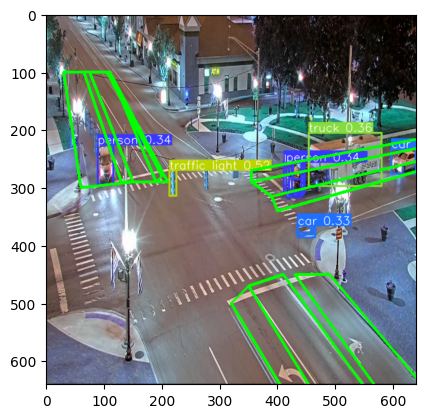

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 0


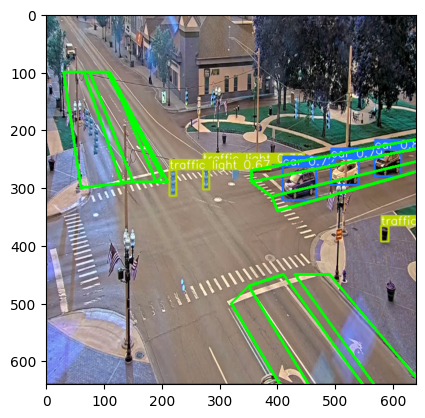

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 0


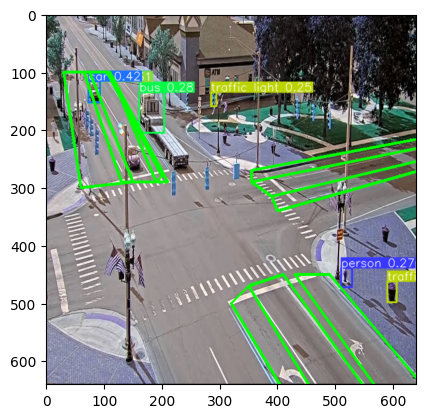

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 0
Lane 9: 0


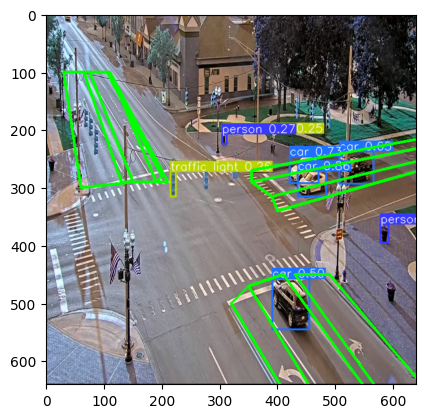

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 1


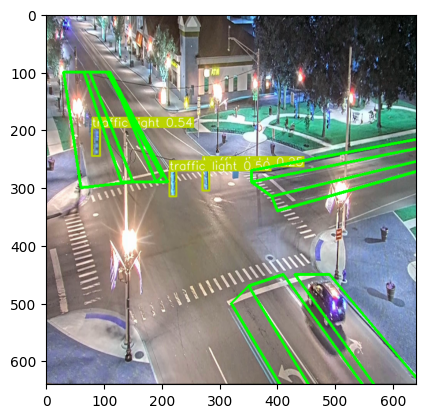

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 0
Lane 9: 0


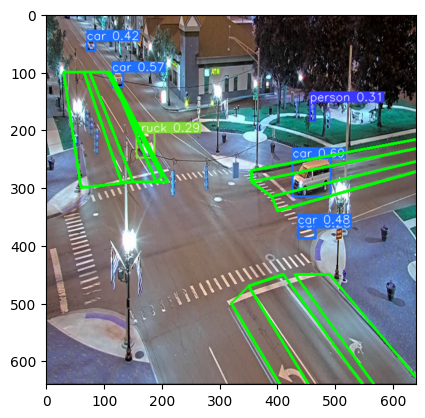

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 0


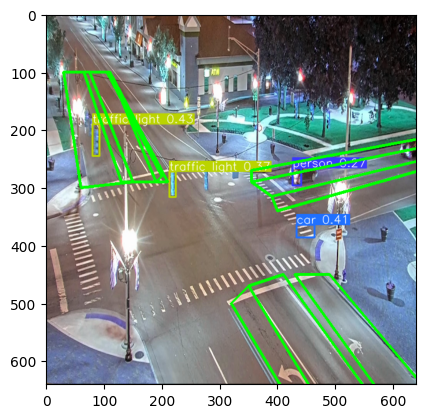

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 0
Lane 9: 0


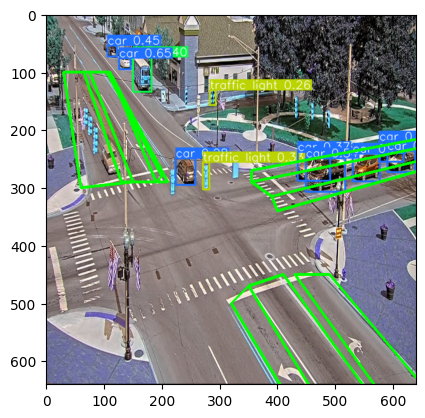

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 0


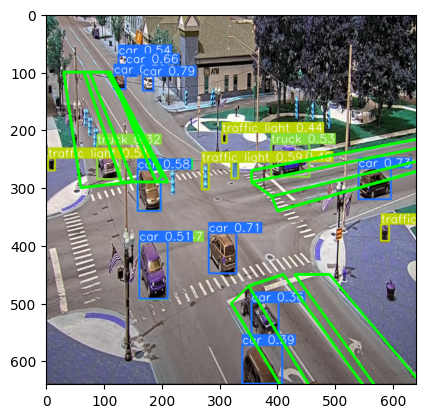

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 1


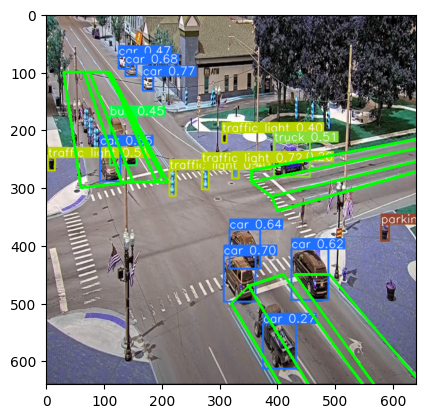

Lane 1: 0
Lane 2: 1
Lane 3: 1
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 1


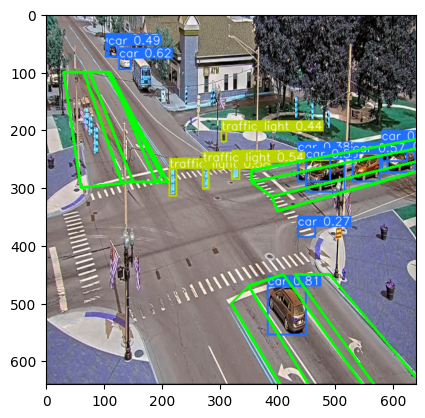

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 1


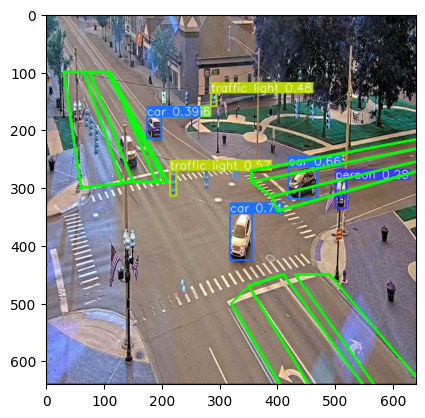

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 0
Lane 5: 0
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 0


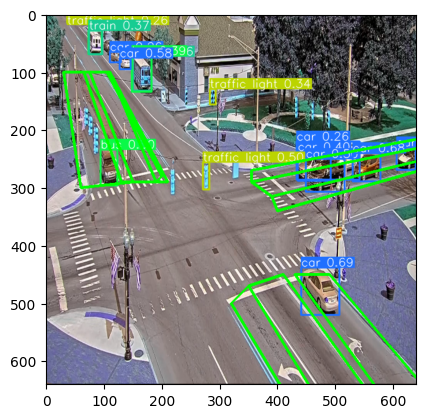

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 0


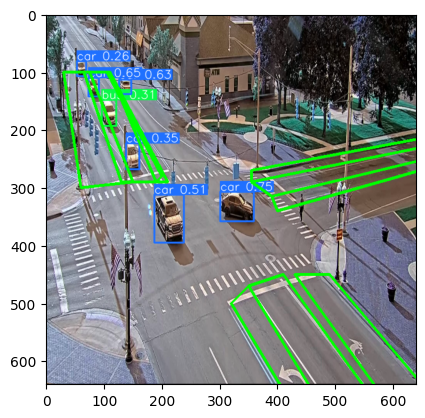

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 0
Lane 9: 0


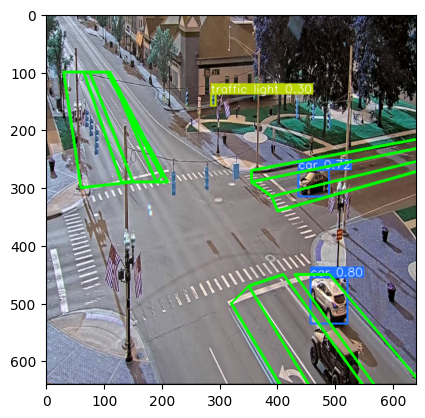

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 0


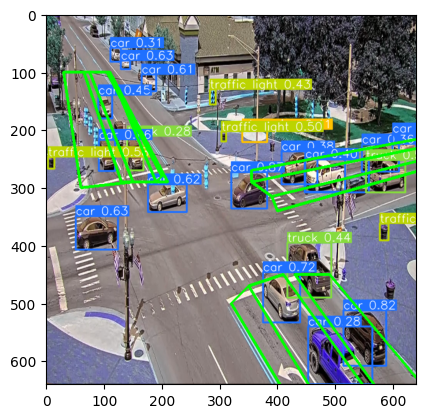

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 1
Lane 8: 1
Lane 9: 1


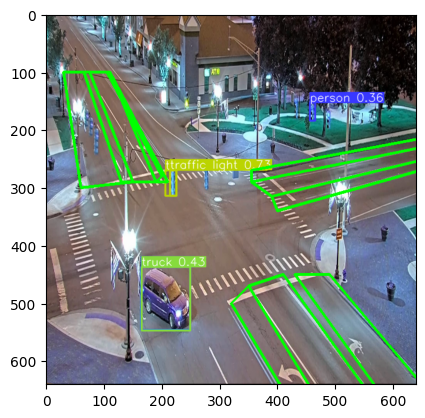

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 0
Lane 9: 0


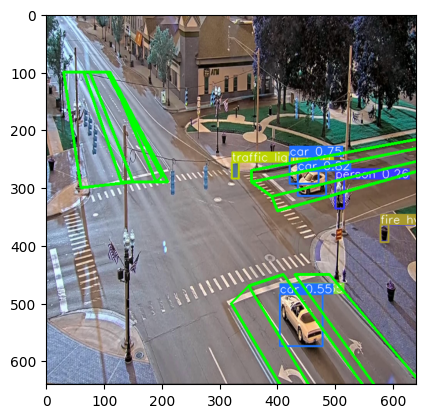

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 1
Lane 5: 0
Lane 6: 1
Lane 7: 0
Lane 8: 1
Lane 9: 1


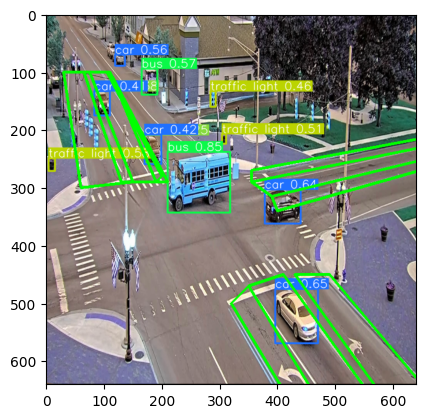

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 1
Lane 9: 1


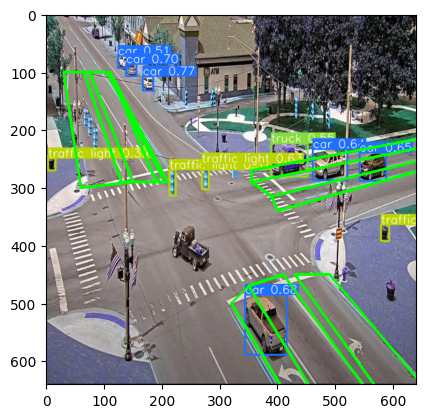

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 1
Lane 9: 1


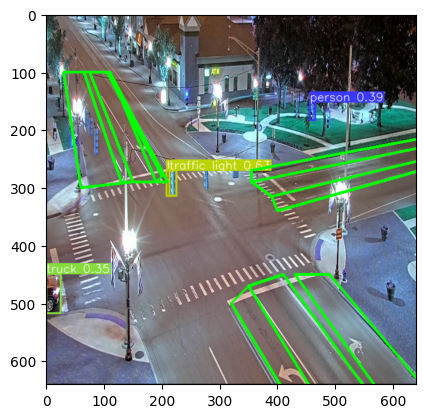

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 0
Lane 9: 0


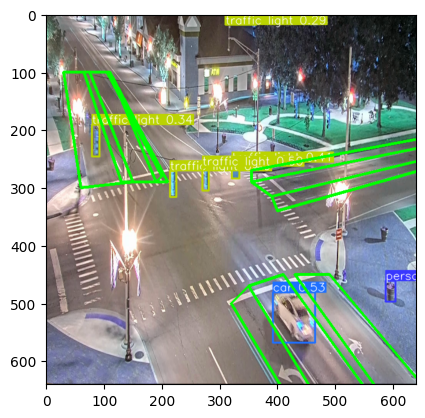

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 1
Lane 9: 1


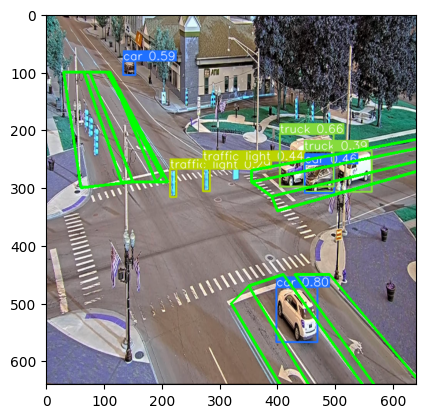

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 1
Lane 9: 1


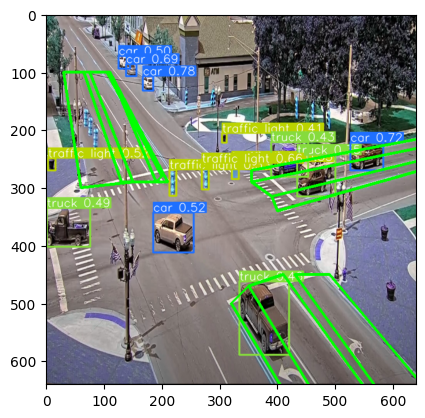

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 1
Lane 9: 1


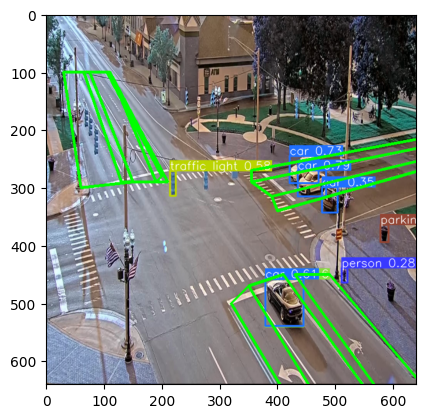

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 1
Lane 5: 0
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 1


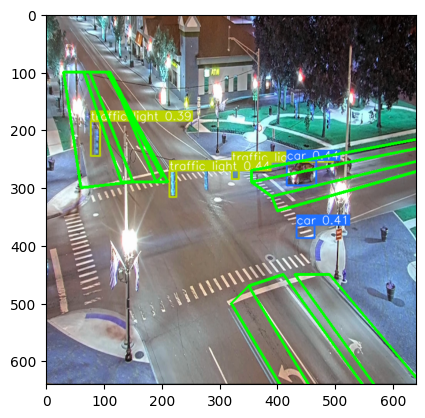

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 1
Lane 5: 0
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 0


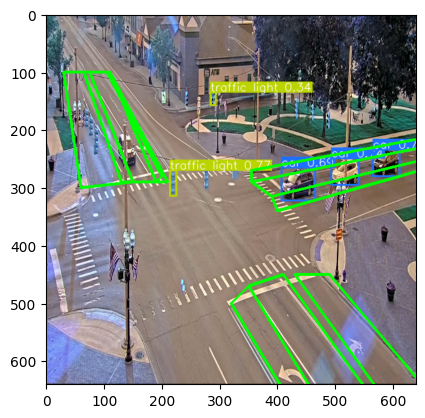

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 0


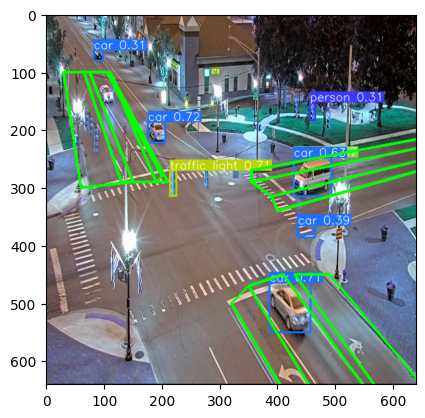

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 1


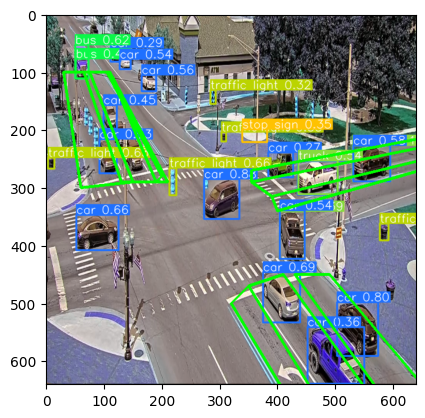

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 1
Lane 8: 1
Lane 9: 1


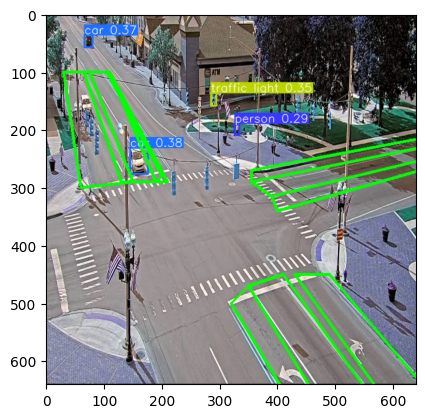

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 0
Lane 9: 0


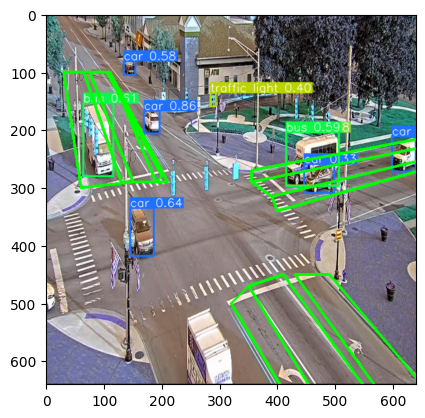

Lane 1: 1
Lane 2: 1
Lane 3: 1
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 0


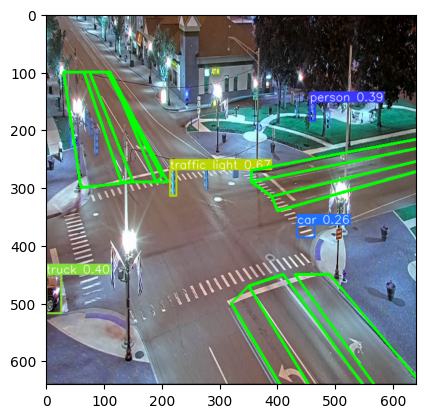

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 0
Lane 9: 0


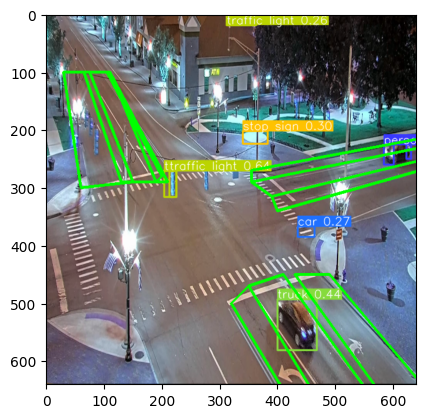

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 0
Lane 9: 1


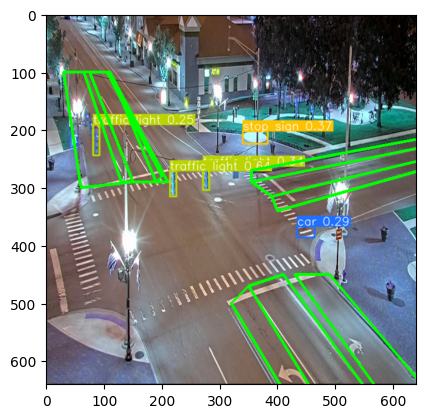

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 0
Lane 9: 0


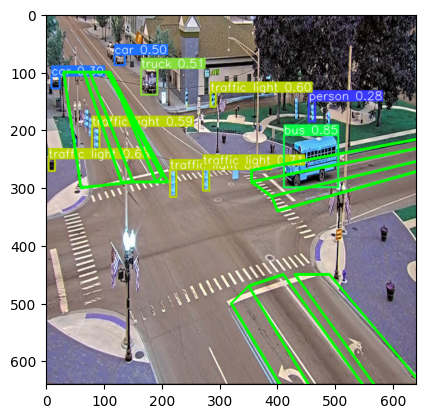

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 0


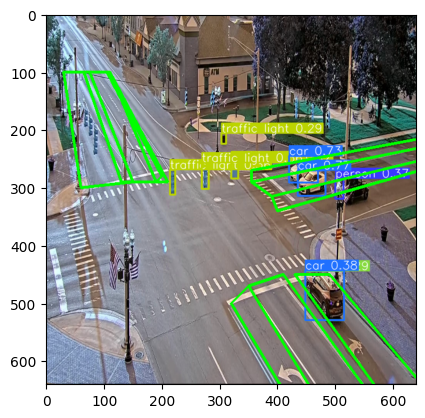

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 1
Lane 5: 0
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 0


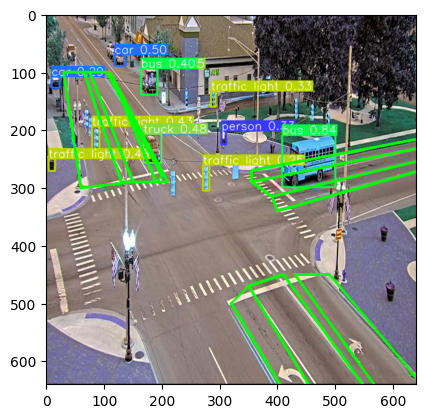

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 0


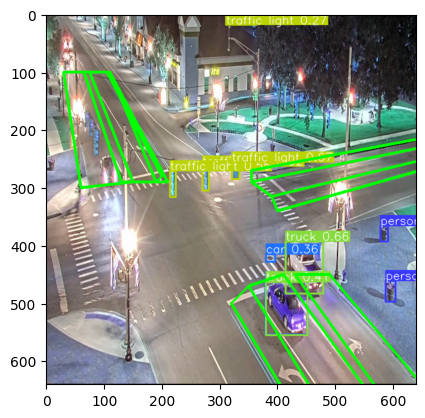

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 1
Lane 9: 1


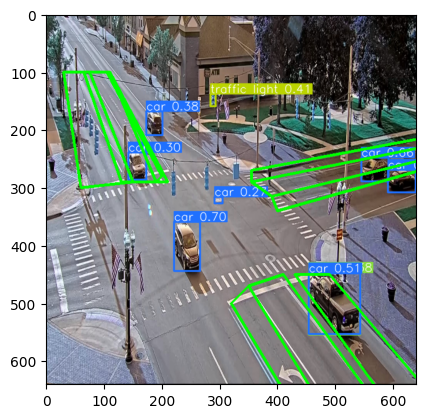

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 1
Lane 5: 0
Lane 6: 1
Lane 7: 1
Lane 8: 1
Lane 9: 0


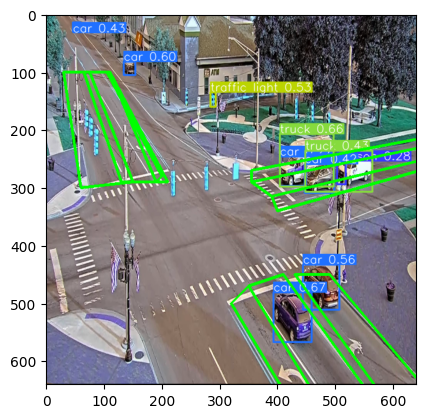

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 1


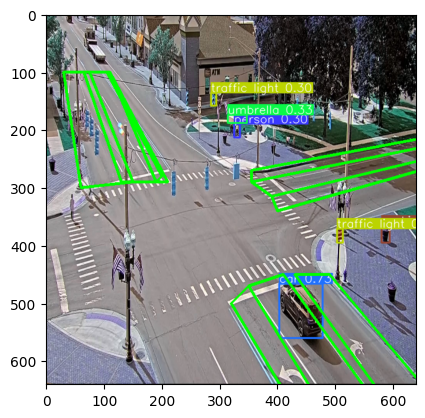

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 1
Lane 9: 1


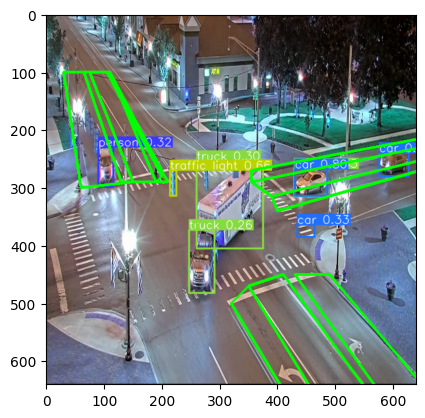

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 0
Lane 8: 0
Lane 9: 0


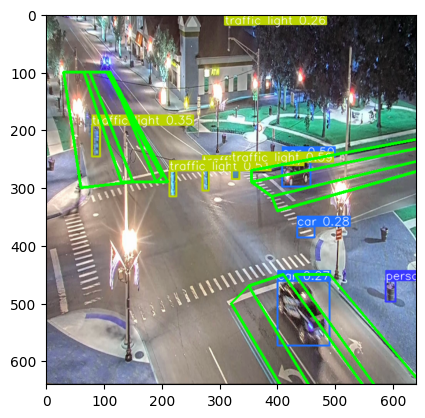

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 1
Lane 5: 0
Lane 6: 1
Lane 7: 1
Lane 8: 1
Lane 9: 1


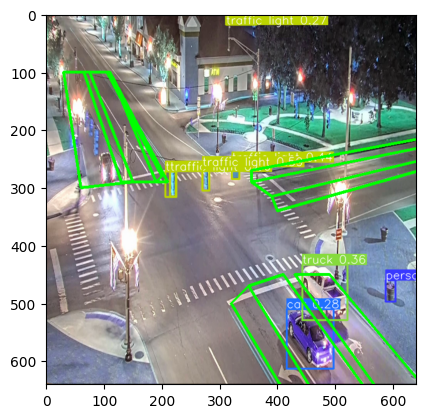

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 1
Lane 8: 1
Lane 9: 1


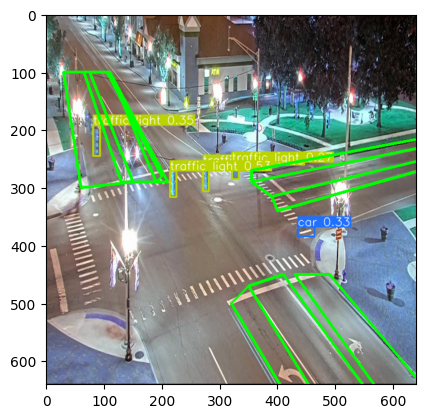

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 0
Lane 9: 0


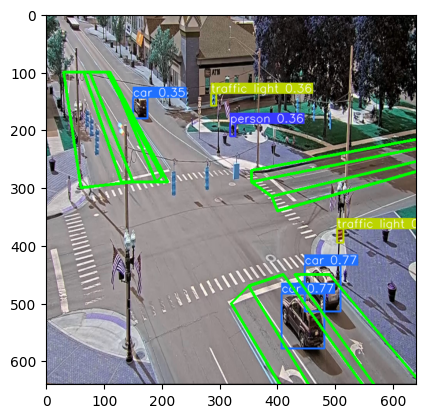

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 1
Lane 9: 1


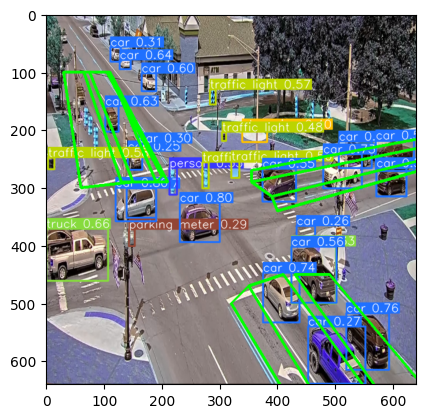

Lane 1: 0
Lane 2: 0
Lane 3: 1
Lane 4: 1
Lane 5: 1
Lane 6: 1
Lane 7: 1
Lane 8: 1
Lane 9: 1


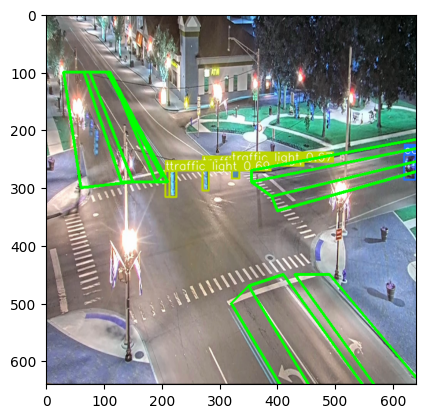

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 0
Lane 9: 0


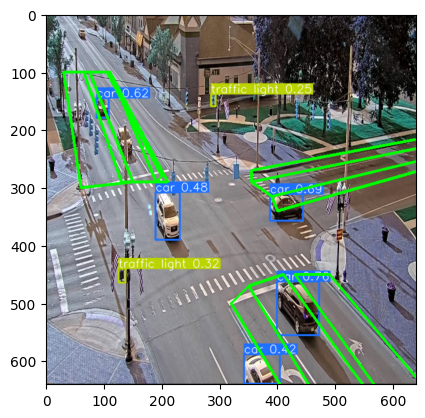

Lane 1: 0
Lane 2: 0
Lane 3: 0
Lane 4: 0
Lane 5: 0
Lane 6: 0
Lane 7: 0
Lane 8: 1
Lane 9: 1


In [ ]:
im_green=[]
ideal_class_idx=[1,2,3,5,6,7]
coord=[]
classes=[]
task1='/content/Task1'

# Placing the coordinates of each point to make polygons as regions of interest
# TOP LEFT side of lanes:
# The first lane
p1 = np.array([[30,100], [60,300], [150,290], [75, 100]], dtype=np.int32)
# The second lane
p2 = np.array([[65, 100], [130,290], [210,290], [110, 100]], dtype=np.int32)
# The third lane
p3 = np.array([[110,100], [190,290], [200,280], [105, 100]], dtype=np.int32)

# RIGHT CENTER side of lanes:
# The first lane
p4 = np.array([[355,270], [700,205], [700,220], [355,290]], dtype=np.int32)
# The second lane
p5 = np.array([[355,290], [700,220], [700,240], [390, 315]], dtype=np.int32)
# The third lane
p6 = np.array([[390, 315], [700,240], [700,255], [400,340]], dtype=np.int32)

# DOWN RIGHT side of lanes
# The first lane
p7 = np.array([[430,450], [610,700], [700,700], [490,450]], dtype=np.int32)
# The second lane
p8 = np.array([[350, 470], [490,700], [590,700], [410,450]], dtype=np.int32)
# The third lane
p9 = np.array([[320,500], [440,700], [490,700], [350, 470]], dtype=np.int32)

# Placing a threshold to to calculate the junction area necessary for a bounding box to be regarded occupying a lane.
trhold = 0.3

txts = glob.glob(task1 + '/*.txt')
outfold = "occupancy_files"
os.makedirs(outfold, exist_ok=True)


# Start to iterate through results provided by the model
for  idx,r in enumerate(res_all):
    res_plot = r[0].plot()
    # Extracting the class and bounding boxes' coordinates for each car that was detected by my model
    boxes = r[0].boxes
    boundbox_cls = boxes.cls
    occupied = [False] * 9
    for box,bb in zip(boxes.xyxy,boundbox_cls):
      x1,y1,x2,y2 = box.tolist()
      cls = int(bb.item())
      coord.append((x1,y1,x2,y2,cls))
      if cls in ideal_class_idx:
        # Checking if the coordinates of the bounding boxes match with the point from p1 to p9
        for i, p in enumerate([p1, p2, p3, p4, p5, p6, p7, p8,p9]):
                  # Get the object's bounding box coordinates.
                  points = np.array([[x1, y1], [x2, y2]])
                  # Define the lane's boundary box
                  lane_bb = np.array([[min(p[:, 0]), min(p[:, 1])], [max(p[:, 0]), max(p[:, 1])]])
                  # Determine the area of intersection between the item and the lane.
                  interarea = max(0, min(points[1, 0], lane_bb[1, 0]) - max(points[0, 0], lane_bb[0, 0])) * \
                      max(0, min(points[1, 1], lane_bb[1, 1]) - max(points[0, 1], lane_bb[0, 1]))
                  # Determmine the lane's area
                  p_area = cv.contourArea(p)

          # If the junction area is larger than or equal to a threshold (trhold), the lane is considered occupied and the occupied list is updated appropriately.
                  if (interarea / p_area) >= trhold:
                      occupied[i] = True

# Projecting green lines on the road lanes stabilized by the point p1 to p9
    img = cv.polylines(res_plot, [p1],True, (0,255,0), 4)
    img = cv.polylines(img, [p2],True, (0,255,0), 4)
    img = cv.polylines(img, [p3],True, (0,255,0), 4)
    img = cv.polylines(img, [p4],True, (0,255,0), 4)
    img = cv.polylines(img, [p5],True, (0,255,0), 4)
    img = cv.polylines(img, [p6],True, (0,255,0), 4)
    img = cv.polylines(img, [p7],True, (0,255,0), 4)
    img = cv.polylines(img, [p8],True, (0,255,0), 4)
    img = cv.polylines(img, [p9],True, (0,255,0), 4)
    im_green.append(img)

# Showing the images with indications whether the lanes are occupied or not
    plt.imshow(img)
    plt.show()
    for i, o in enumerate(occupied):
      status = "1" if o else "0"
      print(f"Lane {i+1}: {status}")

# Making an output folder in which are stored the predicted status of
    occ_name = f"{idx+1}_predicted.txt"
    occupancy_filepath = os.path.join(outfold, occ_name)
    with open(occupancy_filepath, 'w') as file:
          file.write(f"{len(occupied)}\n")
          for i, o in enumerate(occupied):
              lane_status = 1 if o else 0
              file.write(f"{i+1} {lane_status}\n")



In [ ]:
occupancy_folder = '/content/occupancy_files'
task1_folder = '/content/Task1'

# Get the list of occupancy files
occupancy_files = sorted(glob.glob(os.path.join(occupancy_folder, '*_predicted.txt')))
task1_files = sorted(glob.glob(os.path.join(task1_folder, '*.txt')))

for occupancy_file, task1_file in zip(occupancy_files, task1_files):
    # Read the lanes and occupancies from the occupancy file
    with open(occupancy_file, 'r') as file:
        occupancy_lines = file.readlines()
    occupancy_lanes = [line.split()[0] for line in occupancy_lines[1:]]
    occupancy_occupancies = [line.split()[1] for line in occupancy_lines[1:]]

    # Read the lanes and number from the Task1 file
    with open(task1_file, 'r') as file:
        task1_lines = file.readlines()
    task1_number = task1_lines[0].strip()
    task1_lanes = [line.split()[0] for line in task1_lines[1:]]

    # Match the lanes in the occupancy file with the lanes in the Task1 file
    matched_lanes = []
    matched_occupancies = []
    for lane, occupancy in zip(occupancy_lanes, occupancy_occupancies):
        if lane in task1_lanes:
            matched_lanes.append(lane)
            matched_occupancies.append(occupancy)

    # Update the first number in the occupancy file with the number from the Task1 file
    updated_lines = [f"{task1_number}\n"] + [f"{lane} {occupancy}\n" for lane, occupancy in zip(matched_lanes, matched_occupancies)]
    with open(occupancy_file, 'w') as file:
        file.writelines(updated_lines)

In [ ]:
occupancy_folder = '/content/occupancy_files'
ground_truth_folder = '/content/train/Task1/ground-truth'

occupancy_files = sorted(glob.glob(os.path.join(occupancy_folder, 'occupancy_*.txt')))
ground_truth_files = sorted(glob.glob(os.path.join(ground_truth_folder, '*.txt')))

total_correct = 0
total_count = 0

for occupancy_file, ground_truth_file in zip(occupancy_files, ground_truth_files):
    # Read the occupancies from the updated occupancy file
    with open(occupancy_file, 'r') as file:
        occupancy_lines = file.readlines()
    occupancy_occupancies = [int(line.split()[1]) for line in occupancy_lines[1:]]

    # Read the ground truth occupancies
    with open(ground_truth_file, 'r') as file:
        ground_truth_lines = file.readlines()
    ground_truth_occupancies = [int(line.split()[1]) for line in ground_truth_lines[1:]]

    # Compare the occupancies and calculate accuracy
    correct = sum(1 for occ, gt in zip(occupancy_occupancies, ground_truth_occupancies) if occ == gt)
    count = len(occupancy_occupancies)
    accuracy = correct / count

    total_correct += correct
    total_count += count

    print(f"File: {occupancy_file}")
    print(f"GT File: {ground_truth_file}")
    print(f"Correct: {correct} out of {count}")
    print(f"Acc: {accuracy}\n")

total_accuracy = total_correct / total_count
print(f"Overall Acc: {total_accuracy}")

# **TASK 2**

For Task 2 I had to track a specific car all over the video, from the initial frame to the final one.

For this I had to take the IOU (intersection of the union) function and calculate for every bounding box of each car per frame.

In [ ]:
# The arguments represents the coordinates of the 2 bounding boxes
def iou_function(b1, b2):
	# Here it is extracted the coordinates of the boxes and calculated the coord of intersection polygon
	x_1 = max(b1[0], b2[0])
	y_1= max(b1[1], b2[1])
	x_2= min(b1[2], b2[2])
	y_2= min(b1[3], b2[3])
#  Then the are of the intersection is calculated
	intA = max(0, x_2 - x_1 + 1) * max(0, y_2 - y_1 + 1)
#  Area of bounding boxes is calculated
	b1Area = (b1[2] - b1[0] + 1) * (b1[3] - b1[1] + 1)
	b2Area = (b2[2] - b2[0] + 1) * (b2[3] - b2[1] + 1)
#  Finally, the calculation of IOU value
	iou = intA / float(b1Area + b2Area - intA)

	return iou

Again, for this task I am choosing to work with YOLO v8, to track the vehicles accordingly.

In [ ]:
model_task2 = YOLO('yolov8n.pt')
results = model_task2.track(source="/content/Task2/15.mp4", conf=0.3, iou=0.5, show=False)



    WARNING ⚠️ stream/video/webcam/dir predict source will accumulate results in RAM unless `stream=True` is passed,
    causing potential out-of-memory errors for large sources or long-running streams/videos.

    Usage:
        results = model(source=..., stream=True)  # generator of Results objects
        for r in results:
            boxes = r.boxes  # Boxes object for bbox outputs
            masks = r.masks  # Masks object for segment masks outputs
            probs = r.probs  # Class probabilities for classification outputs

video 1/1 (1/721) /content/Task2/15.mp4: 320x640 3 cars, 87.9ms
video 1/1 (2/721) /content/Task2/15.mp4: 320x640 3 cars, 87.2ms
video 1/1 (3/721) /content/Task2/15.mp4: 320x640 3 cars, 80.4ms
video 1/1 (4/721) /content/Task2/15.mp4: 320x640 4 cars, 79.1ms
video 1/1 (5/721) /content/Task2/15.mp4: 320x640 4 cars, 93.1ms
video 1/1 (6/721) /content/Task2/15.mp4: 320x640 4 cars, 82.2ms
video 1/1 (7/721) /content/Task2/15.mp4: 320x640 4 cars, 85.6ms
video 1/1 (

In [ ]:
# I extract all the bounding boxes coordinates per frame and store in a list
bbs=[]
for i, j in enumerate(results):
    bframe = []
    # print("Frame:", i)
    for box in j.boxes.xyxy:
      bbox = box[:4].tolist()
      bbox = [int(coord) for coord in bbox]
      bframe.append(bbox)
    bbs.append(bframe)

In [ ]:
anno_fp = "/content/Task2/15.txt"

# To obtain the initial bounding box coordinates, I read the annotation file.
with open(anno_fp, "r") as file:
    anno = file.readlines()

In [ ]:
# Splitting the annotation file in values that we need to proccess
frame_index, xmin, ymin, xmax, ymax = map(int, anno[1].split())

In [ ]:
# Transforming the values in int for easier display and compute
xmin, ymin, xmax, ymax = int(xmin), int(ymin), int(xmax), int(ymax)

In [ ]:
tracked_bbox = []
desired_bbox = [xmin, ymin, xmax, ymax]
# Here I created myself a directory in which i stored the output
output_file = "/content/Output-Task2/output_15.txt"

# Iterating over each frame and its associated bounding boxes.
for idx, fbox in enumerate(bbs):
    best_iou = 0.0
    best_bbox = None

    # Iterating through the current frame's bounding boxes.
    for bbox in fbox:
        iou = iou_function(desired_bbox, bbox)

        if iou > best_iou:
            best_iou = iou
            best_bbox = bbox

    if best_bbox is not None:
        desired_bbox = best_bbox

    # Adding the best corresponding bounding box to the tracked_bbox list.
    tracked_bbox.append(desired_bbox)

# Writing the first line accordingly
with open(output_file, "w") as f:
        f.write(f"{len(tracked_bbox)+1} -1 -1 -1 -1\n")

    # For each frame, write the tracked bounding boxes.
        for frame_idx, bbox in enumerate(tracked_bbox):
           f.write(f"{frame_idx+1} {bbox[0]} {bbox[1]} {bbox[2]} {bbox[3]}\n")


# Print the tracked bounding boxes for each frame
for frame_idx, bbox in enumerate(tracked_bbox):
    print("Frame:", frame_idx)
    print("Tracked BB:", bbox)

Frame: 0
Tracked BB: [233, 153, 305, 223]
Frame: 1
Tracked BB: [233, 153, 305, 223]
Frame: 2
Tracked BB: [233, 153, 305, 223]
Frame: 3
Tracked BB: [233, 153, 305, 223]
Frame: 4
Tracked BB: [233, 153, 305, 223]
Frame: 5
Tracked BB: [233, 153, 305, 223]
Frame: 6
Tracked BB: [233, 153, 305, 223]
Frame: 7
Tracked BB: [233, 153, 305, 223]
Frame: 8
Tracked BB: [233, 153, 305, 223]
Frame: 9
Tracked BB: [233, 153, 305, 223]
Frame: 10
Tracked BB: [233, 153, 305, 223]
Frame: 11
Tracked BB: [233, 153, 305, 223]
Frame: 12
Tracked BB: [233, 153, 305, 223]
Frame: 13
Tracked BB: [233, 153, 305, 223]
Frame: 14
Tracked BB: [233, 153, 305, 223]
Frame: 15
Tracked BB: [233, 153, 305, 223]
Frame: 16
Tracked BB: [233, 153, 305, 223]
Frame: 17
Tracked BB: [233, 153, 305, 223]
Frame: 18
Tracked BB: [233, 153, 305, 223]
Frame: 19
Tracked BB: [233, 153, 305, 223]
Frame: 20
Tracked BB: [233, 153, 305, 223]
Frame: 21
Tracked BB: [233, 153, 305, 223]
Frame: 22
Tracked BB: [233, 153, 305, 223]
Frame: 23
Tracked BB:

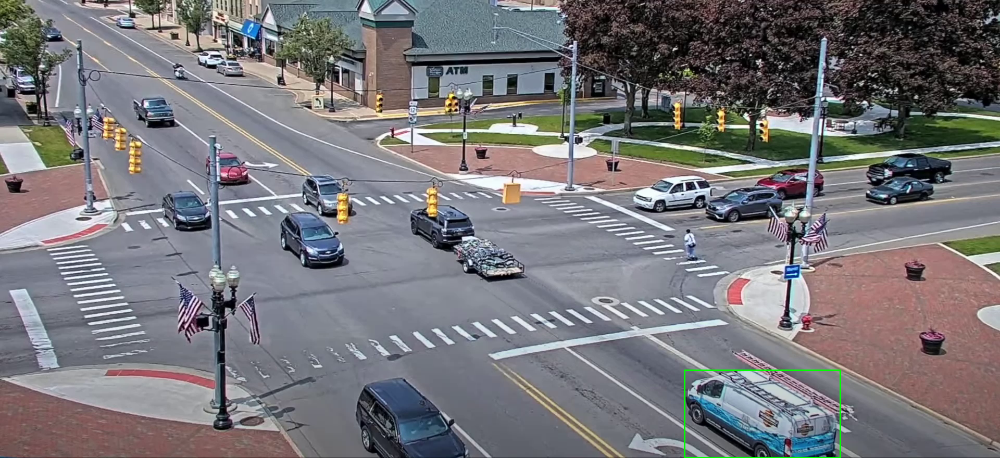

In [ ]:
# Opening the video file
vid_p = "/content/train/Task2/01.mp4"
cap = cv.VideoCapture(vid_p)

fc=0
# Wanting to display only the first 5 frames just to make colab run without crashing
while cap.isOpened() and fc < 5:
  # Iterate over each frame and its corresponding tracked bounding box
  for fid, bb in enumerate(tracked_bbox):
      # Read the frame
      ret, frame = cap.read()
      if bb is not None:
      # Drawing the tracked bounding box on the frame
          xmin, ymin, xmax, ymax = bb
          cv.rectangle(frame, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)

      # Displaying the frame with the tracked bounding box
      cv2_imshow(frame)

      fc+=1





# **TASK 3**

For task 3 I had to count the trajectories of vehicles in each video. How many vehicles went from region 1 to region 2, region 2 to region 3 and so on. For this, I established some new regions  of interest as it follows.

In [ ]:
# Getting the path for ground truth files and the video files
# gt_files = '/content/train/Task3/ground-truth'
video_files = '/content/Task3'

In [ ]:
# Specifying the regions of interest for the sections
# Top Left
roi1 = np.array([[246,404], [125,200], [420,100], [900, 380]], dtype=np.int32)
# Center Right
roi2 = np.array([[1000,370], [1950,280], [1950,455], [1350,540]], dtype=np.int32)
# Bottom Right
roi3 = np.array([[500,750], [560,900], [1950,900], [1450, 610]], dtype=np.int32)
roi = [(roi1, roi2), (roi2, roi3), (roi1, roi3)]

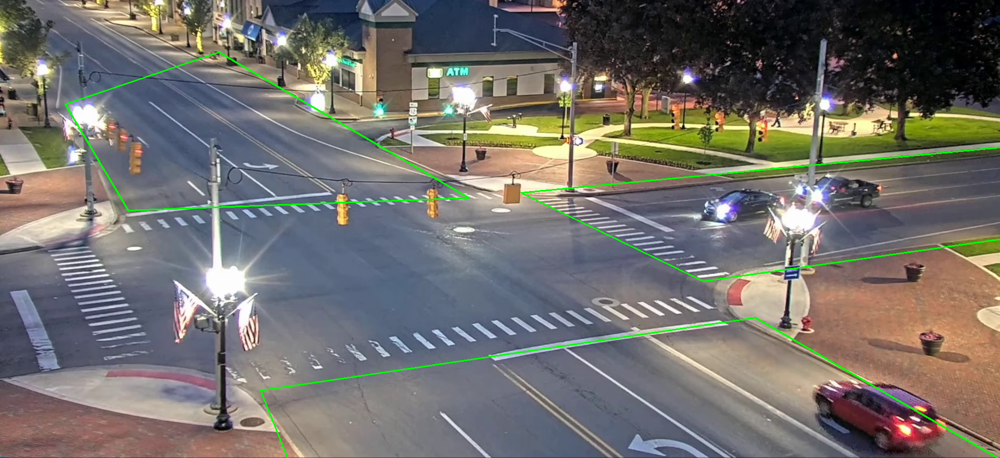

In [ ]:
# Load the video
cap = cv.VideoCapture('/content/Task3/01.mp4')

# Read and display 1 frame just to make sure the polygons are in the right place
frame_count = 0
while cap.isOpened() and frame_count < 1:
    ret, frame = cap.read()
    if not ret:
        break

    # Draw the polygons on the frame
    for region_pair in roi:
        for region in region_pair:
            cv.polylines(frame, [region], True, (0, 255, 0), 2)

    # Display the frame
    cv2_imshow(frame)

    frame_count += 1


In [ ]:
vf = glob.glob(os.path.join(video_files, "*.mp4"))
# Iterating over every video
for v in vf:
  # Getting the name of the video
  name = os.path.splitext(os.path.basename(v))[0]
  gt = os.path.join(gt_files, f"{name}_gt.txt")
  traj = []
  vcount = []

# Getting the data from the .txt files
  with open(gt, "r") as f:
        lines = f.readlines()
        for l in lines:
            t, count = l.strip().split(" ")
            start_region, end_region = map(int, t.split("-"))
            traj.append((start_region, end_region))
            vcount.append(int(count))

In [ ]:
vcount

[0, 1, 1, 1, 1, 1]

In [ ]:
# Of course, for this task I also chose to use the amazing YOLOv8
model_task3 = YOLO('yolov8n.pt')
results3 = model_task3.track(source="/content/Task3/02.mp4", conf=0.3, iou=0.5, show=False)

In [ ]:
vehicle_trajectories=[]
# Getting the bounding boxes coordinates for each car as trajectory
for i, j in enumerate(results3):
    frame_traj = []
    for box in j.boxes.xyxy:
      b = box[:4].tolist()
      b = [int(coord) for coord in b]
      frame_traj.append(b)
    vehicle_trajectories.append(frame_traj)

In [ ]:
# Iterating through frames and checking the coordinates of each car in the frames
for fid, frame_trajectories in enumerate(vehicle_trajectories):
    print("Frame:", fid)
    for vid, v in enumerate(frame_trajectories):
        print("Vehicle:", vid)
        print("Coord:", v)

Streaming output truncated to the last 5000 lines.
Coord: [874, 442, 1009, 536]
Vehicle: 3
Coord: [452, 201, 527, 252]
Frame: 1625
Vehicle: 0
Coord: [535, 318, 639, 402]
Vehicle: 1
Coord: [251, 85, 300, 116]
Vehicle: 2
Coord: [871, 440, 1006, 534]
Vehicle: 3
Coord: [451, 201, 526, 250]
Frame: 1626
Vehicle: 0
Coord: [536, 318, 639, 402]
Vehicle: 1
Coord: [251, 85, 300, 116]
Vehicle: 2
Coord: [870, 439, 1005, 534]
Vehicle: 3
Coord: [451, 201, 525, 249]
Frame: 1627
Vehicle: 0
Coord: [537, 319, 639, 401]
Vehicle: 1
Coord: [251, 83, 299, 116]
Vehicle: 2
Coord: [864, 436, 1003, 530]
Vehicle: 3
Coord: [449, 199, 524, 248]
Frame: 1628
Vehicle: 0
Coord: [538, 319, 639, 401]
Vehicle: 1
Coord: [251, 83, 298, 115]
Vehicle: 2
Coord: [862, 435, 1002, 528]
Vehicle: 3
Coord: [449, 198, 523, 248]
Frame: 1629
Vehicle: 0
Coord: [538, 319, 640, 401]
Vehicle: 1
Coord: [251, 82, 298, 115]
Vehicle: 2
Coord: [862, 435, 1002, 528]
Vehicle: 3
Coord: [449, 198, 523, 248]
Frame: 1630
Vehicle: 0
Coord: [539, 319, 

In my approach, I iterated over each frame's vechicle trajectory and for every vehicle in a frame, which is illustrated as a list of 4 coordinates, and checked if the bounding box can be within any regions of interest that I established. I used pointPolygonTest() function to check ROI, aka to check if any of the 4 points of the bbox fall within region of interest.

I wanted to track all the cars in all frames, I checked whether they are in the region of interest and track them until I find that the car is changing its trajectory (from previous trajectory coordinates to a new ones). When some car is changing their coordinates, I update the count with +1 to the trajectory they went to then stop tracking that car.

In [ ]:
# Initialize the region transition counts
count_dict = {
    '1-2': 0,
    '1-3': 0,
    '2-1': 0,
    '2-3': 0,
    '3-1': 0,
    '3-2': 0
}

# Dictionary to store the stabilized vehicles
stabil_v = {}

# Count the region transitions for each frame
for frame_trajectories in vehicle_trajectories:
    # List to store the vehicles to be counted for the current frame
    count_v = []

    for vehicle in frame_trajectories:
        x1, y1, x2, y2 = vehicle
        vehicle_tuple = (x1, y1, x2, y2)  # Convert the vehicle list to a tuple

        # Check if the bounding box falls within any region of interest
        if cv.pointPolygonTest(roi1, (x1, y1), False) >= 0 or cv.pointPolygonTest(roi1, (x2, y2), False) >= 0:
            prev_region = stabil_v.get(vehicle_tuple, (None, None))
            if prev_region[0] and prev_region[0] != 1:
                region_transition = f"{prev_region[0]}-1"
                count_dict[region_transition] += 1
                count_v.append(vehicle_tuple)
                stabil_v.pop(vehicle_tuple, None)

            stabil_v[vehicle_tuple] = (1, prev_region[1])

        elif cv.pointPolygonTest(roi2, (x1, y1), False) >= 0 or cv.pointPolygonTest(roi2, (x2, y2), False) >= 0:
            prev_region = stabil_v.get(vehicle_tuple, (None, None))
            if prev_region[0] and prev_region[0] != 2:
                region_transition = f"{prev_region[0]}-2"
                count_dict[region_transition] += 1
                count_v.append(vehicle_tuple)
                stabil_v.pop(vehicle_tuple, None)

            stabil_v[vehicle_tuple] = (2, prev_region[1])

        elif cv.pointPolygonTest(roi3, (x1, y1), False) >= 0 or cv.pointPolygonTest(roi3, (x2, y2), False) >= 0:
            prev_region = stabil_v.get(vehicle_tuple, (None, None))
            if prev_region[0] and prev_region[0] != 3:
                region_transition = f"{prev_region[0]}-3"
                count_dict[region_transition] += 1
                count_v.append(vehicle_tuple)
                stabil_v.pop(vehicle_tuple, None)
                stabil_v[vehicle_tuple] = (3, prev_region[1])

    # Remove stabilized vehicles that changed trajectory from the dictionary
    for vehicle in stabil_v.copy():
        if vehicle not in count_v:
            stabil_v.pop(vehicle)

# Print the counts for each region transition
for region_transition, count in count_dict.items():
    print(f"Region: {region_transition}")
    print(f"V Count: {count}")

Region: 1-2
V Count: 0
Region: 1-3
V Count: 0
Region: 2-1
V Count: 0
Region: 2-3
V Count: 0
Region: 3-1
V Count: 0
Region: 3-2
V Count: 0
